Rerunning previosly optimized model.

In [5]:
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
import numpy as np

def print_debug(statement):
    tz_NY = pytz.timezone('America/New_York')
    datetime_NY = datetime.now(tz_NY)
    print(f"{datetime_NY.strftime('%Y-%m-%d %H:%M:%S')} - DEBUG: {statement}")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print_debug(f"Using device: {device}")

dataset_path = "/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages"

train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.file_paths = []
        self.labels = []
        self.label_dict = {'Apoferritin': 0, 'Proteasome': 1}
        
        for class_name in sorted(os.listdir(root_dir)):
            class_dir = os.path.join(root_dir, class_name)
            if os.path.isdir(class_dir):
                for file_name in sorted(os.listdir(class_dir)):
                    if file_name.endswith(".mrc"):
                        self.file_paths.append(os.path.join(class_dir, file_name))
                        self.labels.append(self.label_dict[class_name])
        
        print_debug(f"Total images found: {len(self.file_paths)}")

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print_debug(f"Error loading image; skipping index {idx}. Error: {e}")
            return None
        
        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]

full_dataset = MRCDataset(root_dir=dataset_path, transform=None)
full_dataset = [item for item in full_dataset if item is not None]
print_debug(f"Total valid images in dataset: {len(full_dataset)}")

if len(full_dataset) == 0:
    raise ValueError("No valid images found in the dataset. Please check the dataset path and file formats.")

train_size = int(0.8 * len(full_dataset))
test_size = len(full_dataset) - train_size
torch.manual_seed(0)  # Set a random seed for reproducibility
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

class CustomImageDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, transform=None):
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        image, label = self.dataset.dataset[self.dataset.indices[idx]]
        if self.transform:
            image = self.transform(image)
        return image, label

train_dataset = CustomImageDataset(train_dataset, transform=train_transform)
test_dataset = CustomImageDataset(test_dataset, transform=test_transform)

batch_size = 64

def collate_fn(batch):
    batch = list(filter(lambda x: x is not None, batch))
    return torch.utils.data.dataloader.default_collate(batch)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4, collate_fn=collate_fn)

class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        self.fc1 = nn.Linear(128 * 28 * 28, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, 128 * 28 * 28)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x))) 
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x

model = MyModel()


if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)
model = model.to(device)

# Proper weight initialization
def weights_init(m):
    if isinstance(m, nn.Conv2d):
        nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='leaky_relu')
    elif isinstance(m, nn.Linear):
        nn.init.xavier_normal_(m.weight)

model.apply(weights_init)

optimizer = optim.Adam(model.parameters(), lr=0.0000001)
criterion = nn.BCELoss()

def evaluate_model(model, data_loader, criterion, device):
    model.eval()
    total_loss = 0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            labels = labels.float()  # Ensure labels are float for BCELoss
            loss = criterion(outputs, labels)
            total_loss += loss.item()
            predicted = torch.round(outputs)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    average_loss = total_loss / len(data_loader)
    accuracy = 100 * correct / total
    return average_loss, accuracy

# Evaluate the model initially
initial_train_loss, initial_train_accuracy = evaluate_model(model, train_loader, criterion, device)
initial_val_loss, initial_val_accuracy = evaluate_model(model, test_loader, criterion, device)

print_debug(f'Initial Train Loss: {initial_train_loss}, Initial Train Accuracy: {initial_train_accuracy}%')
print_debug(f'Initial Validation Loss: {initial_val_loss}, Initial Validation Accuracy: {initial_val_accuracy}%')

# Initialize lists for plotting
train_losses = [initial_train_loss]
val_losses = [initial_val_loss]
train_accuracies = [initial_train_accuracy]
val_accuracies = [initial_val_accuracy]

num_epochs = 150
best_val_loss = float('inf')
last_improvement = 0
patience = 50

# Implement gradient clipping
max_norm = 1.0  # Adjust the max norm value as needed

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0
    correct = 0
    total = 0
    for inputs, labels in train_loader:
        if inputs is None:
            continue
        inputs, labels = inputs.to(device), labels.to(device)
        labels = labels.float()
        optimizer.zero_grad()
        outputs = model(inputs)
        outputs = outputs.squeeze(1)
        loss = criterion(outputs, labels)
        loss.backward()
        
        # Apply gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)
        
        optimizer.step()

        train_loss += loss.item()
        predicted = (outputs > 0.5).float()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss /= len(train_loader)
    train_accuracy = 100 * correct / total
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    print_debug(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%.")

    model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            if inputs is None:
                continue
            inputs, labels = inputs.to(device), labels.to(device)
            labels = labels.float()
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            predicted = (outputs > 0.5).float()
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss /= len(test_loader)
    val_accuracy = 100 * val_correct / val_total
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    print_debug(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%.")

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        last_improvement = epoch
        torch.save(model.state_dict(), '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1.pth')
        print_debug(f"Model improved and saved at epoch {epoch+1} into the file CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip.pth_1.")

    if epoch - last_improvement > patience:
        print_debug("No improvement in validation loss for several epochs, stopping training.")
        break

# Calculate the actual number of epochs data was collected
actual_num_epochs = len(train_losses)  # Assuming train_losses and val_losses are updated every epoch

plt.figure(figsize=(10, 4))

# Plot training and validation loss
plt.subplot(1, 2, 1)
plt.plot(range(actual_num_epochs), train_losses, label='Train Loss')
plt.plot(range(actual_num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epoch', color='black')
plt.ylabel('Loss', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(range(actual_num_epochs), train_accuracies, label='Train Accuracy')
plt.plot(range(actual_num_epochs), val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch', color='black')
plt.ylabel('Accuracy', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

plt.show()

2024-09-07 17:49:54 - DEBUG: Using device: cuda
The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.
2024-09-07 17:49:54 - DEBUG: Total images found: 200000


KeyboardInterrupt: 

Retraining of last layers on real data /home/semc/Aygul_DL/Deep-learning/m24jun19d_apof_protea.

In [ ]:
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
import numpy as np
from collections import OrderedDict

def print_debug(statement):
    tz_NY = pytz.timezone('America/New_York')
    datetime_NY = datetime.now(tz_NY)
    print(f"{datetime_NY.strftime('%Y-%m-%d %H:%M:%S')} - DEBUG: {statement}")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print_debug(f"Using device: {device}")

dataset_path = "/home/semc/Aygul_DL/Deep-learning/m24jun19d_apof_protea"

train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])


class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.file_paths = []
        self.labels = []
        self.label_dict = {'Apoferritin': 0, 'Proteasome': 1}
        
        for class_name in sorted(os.listdir(root_dir)):
            class_dir = os.path.join(root_dir, class_name)
            if os.path.isdir(class_dir):
                for file_name in sorted(os.listdir(class_dir)):
                    if file_name.endswith(".mrc"):
                        self.file_paths.append(os.path.join(class_dir, file_name))
                        self.labels.append(self.label_dict[class_name])
        
        print_debug(f"Total images found: {len(self.file_paths)}")

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print_debug(f"Error loading image; skipping index {idx}. Error: {e}")
            return None
        
        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]

full_dataset = MRCDataset(root_dir=dataset_path, transform=None)
full_dataset = [item for item in full_dataset if item is not None]
print_debug(f"Total valid images in dataset: {len(full_dataset)}")

if len(full_dataset) == 0:
    raise ValueError("No valid images found in the dataset. Please check the dataset path and file formats.")

train_size = int(0.8 * len(full_dataset))
test_size = len(full_dataset) - train_size
torch.manual_seed(0)  # Set a random seed for reproducibility
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

class CustomImageDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, transform=None):
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        image, label = self.dataset.dataset[self.dataset.indices[idx]]
        if self.transform:
            image = self.transform(image)
        return image, label

train_dataset = CustomImageDataset(train_dataset, transform=train_transform)
test_dataset = CustomImageDataset(test_dataset, transform=test_transform)

batch_size = 64

def collate_fn(batch):
    batch = list(filter(lambda x: x is not None, batch))
    return torch.utils.data.dataloader.default_collate(batch)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4, collate_fn=collate_fn)

class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        self.fc1 = nn.Linear(128 * 28 * 28, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, 128 * 28 * 28)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x))) 
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x


# Load the pretrained model
pretrained_model = MyModel()
new_state_dict = OrderedDict()
for k, v in torch.load('/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1.pth').items():
    name = k[7:]  # remove `module.` prefix
    new_state_dict[name] = v
pretrained_model.load_state_dict(new_state_dict)

# Replace the fully connected layers with new ones
pretrained_model.fc1 = nn.Linear(128 * 28 * 28, 128)
pretrained_model.batch_norm_fc1 = nn.BatchNorm1d(128)
pretrained_model.fc2 = nn.Linear(128, 1)
pretrained_model.batch_norm_fc2 = nn.BatchNorm1d(1)

# Freeze the convolutional layers
for param in pretrained_model.conv1.parameters():
    param.requires_grad = False
for param in pretrained_model.conv2.parameters():
    param.requires_grad = False
for param in pretrained_model.conv3.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm1.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm2.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm3.parameters():
    param.requires_grad = False

# Assign the pretrained_model to model
model = pretrained_model

if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)
model = model.to(device)


# Proper weight initialization
def weights_init(m):
    if isinstance(m, nn.Conv2d):
        nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='leaky_relu')
    elif isinstance(m, nn.Linear):
        nn.init.xavier_normal_(m.weight)

model.apply(weights_init)

# Only optimize the fully connected layers
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.001)
criterion = nn.BCELoss()

def evaluate_model(model, data_loader, criterion, device):
    model.eval()
    total_loss = 0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            labels = labels.float()  # Ensure labels are float for BCELoss
            loss = criterion(outputs, labels)
            total_loss += loss.item()
            predicted = torch.round(outputs)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    average_loss = total_loss / len(data_loader)
    accuracy = 100 * correct / total
    return average_loss, accuracy

# Evaluate the model initially
initial_train_loss, initial_train_accuracy = evaluate_model(model, train_loader, criterion, device)
initial_val_loss, initial_val_accuracy = evaluate_model(model, test_loader, criterion, device)

print_debug(f'Initial Train Loss: {initial_train_loss}, Initial Train Accuracy: {initial_train_accuracy}%')
print_debug(f'Initial Validation Loss: {initial_val_loss}, Initial Validation Accuracy: {initial_val_accuracy}%')

# Initialize lists for plotting
train_losses = [initial_train_loss]
val_losses = [initial_val_loss]
train_accuracies = [initial_train_accuracy]
val_accuracies = [initial_val_accuracy]

num_epochs = 150
best_val_loss = float('inf')
last_improvement = 0
patience = 50

# Implement gradient clipping
max_norm = 1.0  # Adjust the max norm value as needed

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0
    correct = 0
    total = 0
    for inputs, labels in train_loader:
        if inputs is None:
            continue
        inputs, labels = inputs.to(device), labels.to(device)
        labels = labels.float()
        optimizer.zero_grad()
        outputs = model(inputs)
        outputs = outputs.squeeze(1)
        loss = criterion(outputs, labels)
        loss.backward()
        
        # Apply gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)
        
        optimizer.step()

        train_loss += loss.item()
        predicted = (outputs > 0.5).float()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss /= len(train_loader)
    train_accuracy = 100 * correct / total
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    print_debug(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%.")

    model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            if inputs is None:
                continue
            inputs, labels = inputs.to(device), labels.to(device)
            labels = labels.float()
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            predicted = (outputs > 0.5).float()
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss /= len(test_loader)
    val_accuracy = 100 * val_correct / val_total
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    print_debug(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%.")

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        last_improvement = epoch
        torch.save(model.state_dict(), '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain1.pth')
        print_debug(f"Model improved and saved at epoch {epoch+1} into the file CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip.pth_1_lastLayerRetrain1.pth")

    if epoch - last_improvement > patience:
        print_debug("No improvement in validation loss for several epochs, stopping training.")
        break

# Calculate the actual number of epochs data was collected
actual_num_epochs = len(train_losses)  # Assuming train_losses and val_losses are updated every epoch

plt.figure(figsize=(10, 4))

# Plot training and validation loss
plt.subplot(1, 2, 1)
plt.plot(range(actual_num_epochs), train_losses, label='Train Loss')
plt.plot(range(actual_num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epoch', color='black')
plt.ylabel('Loss', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(range(actual_num_epochs), train_accuracies, label='Train Accuracy')
plt.plot(range(actual_num_epochs), val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch', color='black')
plt.ylabel('Accuracy', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

plt.show()

Retraining didn't work well.
Now, do the training of all wights the beginning only on these 800 images of ApoF and Proteasome (/home/semc/Aygul_DL/Deep-learning/m24jun19d_apof_protea).

In [ ]:
model = MyModel()
if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)
model = model.to(device)


optimizer = optim.Adam(model.parameters(), lr=0.000001)
criterion = nn.BCELoss()


def evaluate_model(model, data_loader, criterion, device):
    model.eval()
    total_loss = 0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            labels = labels.float()  # Ensure labels are float for BCELoss
            loss = criterion(outputs, labels)
            total_loss += loss.item()
            predicted = torch.round(outputs)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
#            print_debug(f"Processed batch with {len(inputs)} inputs.")  # Debug each batch

    average_loss = total_loss / len(data_loader)
    accuracy = 100 * correct / total
    return average_loss, accuracy


# Evaluate the model initially
initial_train_loss, initial_train_accuracy = evaluate_model(model, train_loader, criterion, device)
initial_val_loss, initial_val_accuracy = evaluate_model(model, test_loader, criterion, device)


print_debug(f'Initial Train Loss: {initial_train_loss}, Initial Train Accuracy: {initial_train_accuracy}%')
print_debug(f'Initial Validation Loss: {initial_val_loss}, Initial Validation Accuracy: {initial_val_accuracy}%')


# Initialize lists for plotting
train_losses = [initial_train_loss]
val_losses = [initial_val_loss]
train_accuracies = [initial_train_accuracy]
val_accuracies = [initial_val_accuracy]


num_epochs = 150
best_val_loss = float('inf')
last_improvement = 0
patience = 150



for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0
    correct = 0
    total = 0
    for inputs, labels in train_loader:
        if inputs is None:
            continue
        inputs, labels = inputs.to(device), labels.to(device)
        labels = labels.float()
        optimizer.zero_grad()
        outputs = model(inputs)
        outputs = outputs.squeeze(1)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        predicted = (outputs > 0.5).float()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss /= len(train_loader)
    train_accuracy = 100 * correct / total
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    print_debug(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%.")

    model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            if inputs is None:
                continue
            inputs, labels = inputs.to(device), labels.to(device)
            labels = labels.float()
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            predicted = (outputs > 0.5).float()
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss /= len(test_loader)
    val_accuracy = 100 * val_correct / val_total
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    print_debug(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%.")

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        last_improvement = epoch
        torch.save(model.state_dict(), '/home/semc/Aygul_DL/Deep-learning/cryoEM_thinIce_40kImages/CryoEM_model2_newImages_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_000001.pth')
        print_debug(f"Model improved and saved at epoch {epoch+1} into the file CryoEM_thinIce_40kImages_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_000001.pth.")

    if epoch - last_improvement > patience:
        print_debug("No improvement in validation loss for several epochs, stopping training.")
        break


# Calculate the actual number of epochs data was collected
actual_num_epochs = len(train_losses)  # Assuming train_losses and val_losses are updated every epoch


plt.figure(figsize=(10, 4))

# Plot training and validation loss
plt.subplot(1, 2, 1)
plt.plot(range(actual_num_epochs), train_losses, label='Train Loss')
plt.plot(range(actual_num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epoch', color='black')
plt.ylabel('Loss', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()


# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(range(actual_num_epochs), train_accuracies, label='Train Accuracy')
plt.plot(range(actual_num_epochs), val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch', color='black')
plt.ylabel('Accuracy', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()


plt.show()

Conclusion: traning of all weihgts on these real 800 images doesn't work.

Now, test if retrainig on real images where classes come from different datasets (background is potentially different). Dataset /home/semc/Aygul_DL/Deep-learning/Real_images.

In [ ]:
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
import numpy as np
from collections import OrderedDict

def print_debug(statement):
    tz_NY = pytz.timezone('America/New_York')
    datetime_NY = datetime.now(tz_NY)
    print(f"{datetime_NY.strftime('%Y-%m-%d %H:%M:%S')} - DEBUG: {statement}")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print_debug(f"Using device: {device}")

dataset_path = "/home/semc/Aygul_DL/Deep-learning/Real_images"

# Transformation without changing pixel size
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])


class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.file_paths = []
        self.labels = []
        self.label_dict = {'Apoferritin': 0, 'Proteasome': 1}
        
        for class_name in sorted(os.listdir(root_dir)):
            class_dir = os.path.join(root_dir, class_name)
            if os.path.isdir(class_dir):
                for file_name in sorted(os.listdir(class_dir)):
                    if file_name.endswith(".mrc"):
                        self.file_paths.append(os.path.join(class_dir, file_name))
                        self.labels.append(self.label_dict[class_name])
        
        print_debug(f"Total images found: {len(self.file_paths)}")

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print_debug(f"Error loading image; skipping index {idx}. Error: {e}")
            return None
        
        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]

full_dataset = MRCDataset(root_dir=dataset_path, transform=None)
full_dataset = [item for item in full_dataset if item is not None]
print_debug(f"Total valid images in dataset: {len(full_dataset)}")

if len(full_dataset) == 0:
    raise ValueError("No valid images found in the dataset. Please check the dataset path and file formats.")

train_size = int(0.8 * len(full_dataset))
test_size = len(full_dataset) - train_size
torch.manual_seed(0)  # Set a random seed for reproducibility
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

class CustomImageDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, transform=None):
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        image, label = self.dataset.dataset[self.dataset.indices[idx]]
        if self.transform:
            image = self.transform(image)
        return image, label

train_dataset = CustomImageDataset(train_dataset, transform=train_transform)
test_dataset = CustomImageDataset(test_dataset, transform=test_transform)

batch_size = 64

def collate_fn(batch):
    batch = list(filter(lambda x: x is not None, batch))
    return torch.utils.data.dataloader.default_collate(batch)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4, collate_fn=collate_fn)

class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        self.fc1 = nn.Linear(128 * 28 * 28, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, 128 * 28 * 28)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x)))
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x

# Load the pretrained model
pretrained_model = MyModel()
pretrained_model = torch.nn.DataParallel(pretrained_model)
pretrained_model.load_state_dict(torch.load('/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1.pth'))
pretrained_model = pretrained_model.module

# Replace the fully connected layers with new ones
pretrained_model.fc1 = nn.Linear(128 * 28 * 28, 128)
pretrained_model.batch_norm_fc1 = nn.BatchNorm1d(128)
pretrained_model.fc2 = nn.Linear(128, 1)
pretrained_model.batch_norm_fc2 = nn.BatchNorm1d(1)

# Freeze the convolutional layers
for param in pretrained_model.conv1.parameters():
    param.requires_grad = False
for param in pretrained_model.conv2.parameters():
    param.requires_grad = False
for param in pretrained_model.conv3.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm1.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm2.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm3.parameters():
    param.requires_grad = False

# Unfreeze the fully connected layers
for param in pretrained_model.fc1.parameters():
    param.requires_grad = True
for param in pretrained_model.batch_norm_fc1.parameters():
    param.requires_grad = True
for param in pretrained_model.fc2.parameters():
    param.requires_grad = True
for param in pretrained_model.batch_norm_fc2.parameters():
    param.requires_grad = True

# Assign the pretrained_model to model
model = pretrained_model

if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)
model = model.to(device)

# Proper weight initialization
def weights_init(m):
    if isinstance(m, nn.Linear):
        if m.weight.requires_grad:
            nn.init.xavier_normal_(m.weight)

model.apply(weights_init)

# Only optimize the fully connected layers
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.0000001)
criterion = nn.BCELoss()

def evaluate_model(model, data_loader, criterion, device):
    model.eval()
    total_loss = 0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            labels = labels.float()  # Ensure labels are float for BCELoss
            loss = criterion(outputs, labels)
            total_loss += loss.item()
            predicted = torch.round(outputs)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    average_loss = total_loss / len(data_loader)
    accuracy = 100 * correct / total
    return average_loss, accuracy

# Evaluate the model initially
initial_train_loss, initial_train_accuracy = evaluate_model(model, train_loader, criterion, device)
initial_val_loss, initial_val_accuracy = evaluate_model(model, test_loader, criterion, device)

print_debug(f'Initial Train Loss: {initial_train_loss}, Initial Train Accuracy: {initial_train_accuracy}%')
print_debug(f'Initial Validation Loss: {initial_val_loss}, Initial Validation Accuracy: {initial_val_accuracy}%')

# Initialize lists for plotting
train_losses = [initial_train_loss]
val_losses = [initial_val_loss]
train_accuracies = [initial_train_accuracy]
val_accuracies = [initial_val_accuracy]

num_epochs = 150
best_val_loss = float('inf')
last_improvement = 0
patience = 50

# Implement gradient clipping
max_norm = 1.0  # Adjust the max norm value as needed

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0
    correct = 0
    total = 0
    for inputs, labels in train_loader:
        if inputs is None:
            continue
        inputs, labels = inputs.to(device), labels.to(device)
        labels = labels.float()
        optimizer.zero_grad()
        outputs = model(inputs)
        outputs = outputs.squeeze(1)
        loss = criterion(outputs, labels)
        loss.backward()
        
        # Apply gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)
        
        optimizer.step()

        train_loss += loss.item()
        predicted = (outputs > 0.5).float()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss /= len(train_loader)
    train_accuracy = 100 * correct / total
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    print_debug(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%.")

    model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            if inputs is None:
                continue
            inputs, labels = inputs.to(device), labels.to(device)
            labels = labels.float()
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            predicted = (outputs > 0.5).float()
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss /= len(test_loader)
    val_accuracy = 100 * val_correct / val_total
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    print_debug(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%.")

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        last_improvement = epoch
        torch.save(model.state_dict(), '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_2.pth')
        print_debug(f"Model improved and saved at epoch {epoch+1} into the file CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_2.pth")

    if epoch - last_improvement > patience:
        print_debug("No improvement in validation loss for several epochs, stopping training.")
        break

# Calculate the actual number of epochs data was collected
actual_num_epochs = len(train_losses)  # Assuming train_losses and val_losses are updated every epoch

plt.figure(figsize=(10, 4))

# Plot training and validation loss
plt.subplot(1, 2, 1)
plt.plot(range(actual_num_epochs), train_losses, label='Train Loss')
plt.plot(range(actual_num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epoch', color='black')
plt.ylabel('Loss', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(range(actual_num_epochs), train_accuracies, label='Train Accuracy')
plt.plot(range(actual_num_epochs), val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch', color='black')
plt.ylabel('Accuracy', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

plt.show()

Conclusion: This approach gives very good results! That means retraining last layers on real data works but not for the dataset m24jun19d_apof_protea. Maybe because ice is too thick in the m24jun19d_apof_protea dataset or this time most signal is coming from the background (data Dataset /home/semc/Aygul_DL/Deep-learning/Real_images are real images where apoferritin and proteasome were collected on different scopes/days/etc).

/tmp/ipykernel_47809/2813426547.py:54: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(model_path, map_location="cpu")


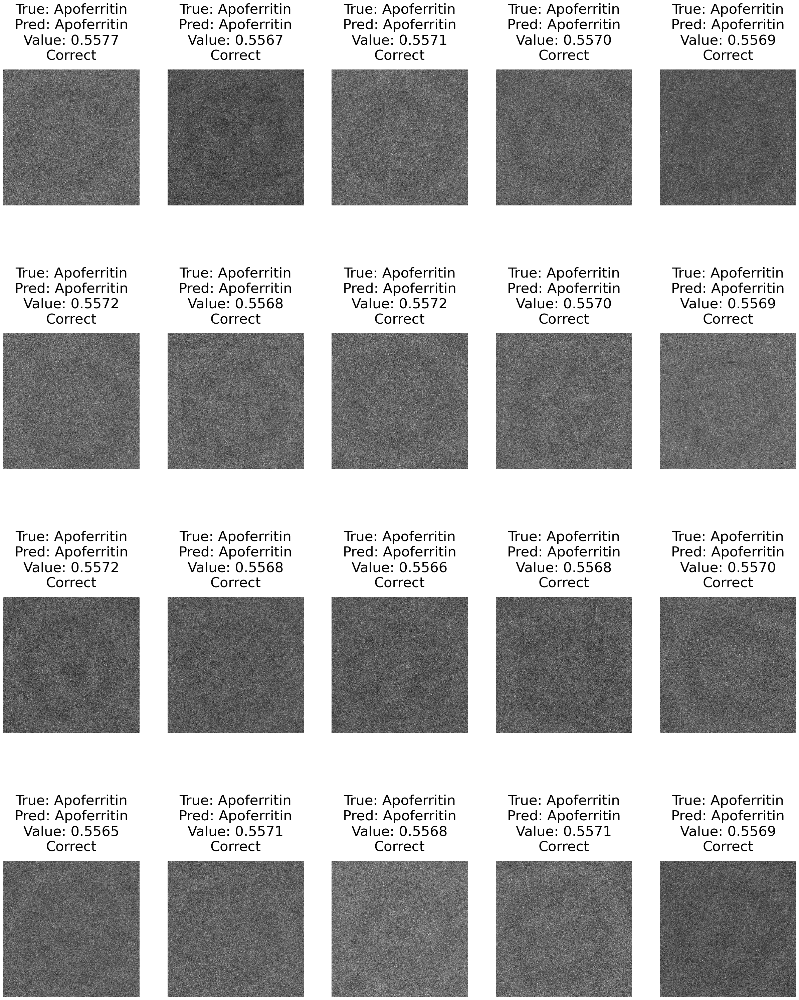

Accuracy: 100.00%


In [14]:
# Prediction the real data (ApoF_m23nov22c_20)
# using model CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_2.pth
# that was tarined on synthetic data anf last layers were retrained on real data:

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
import numpy as np
import math

class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        self.fc1 = nn.Linear(128 * 28 * 28, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, 128 * 28 * 28)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x))) 
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x

model = MyModel()

# Load model function that adapts to whether the model was trained with DataParallel
def load_model(model_path, model, device):
    state_dict = torch.load(model_path, map_location="cpu")
    new_state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
    model.load_state_dict(new_state_dict)
    model = model.to(device)
    return model

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_path = '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_2.pth'
model = MyModel()
model = load_model(model_path, model, device)

# Define the image transform for validation (should be the same as during validation in training)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, file_paths, labels, transform=None):
        self.file_paths = file_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print(f"Error loading image; skipping index {idx}. Error: {e}")
            return None

        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]

def predict(model, data_loader, device):
    model.eval()
    results = {}
    pred_values = {}
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            predictions = torch.sigmoid(outputs).cpu().numpy()
            for idx, pred in enumerate(predictions):
                label = "Proteasome" if pred > 0.6 else "Apoferritin"
                results[labels[idx]] = label
                pred_values[labels[idx]] = pred.item()  # Extract scalar value
    return results, pred_values

# Path to your image folder
folder_path = "/home/semc/Aygul_DL/Deep-learning/ApoF_m23nov22c_20"
file_paths = [os.path.join(folder_path, fname) for fname in os.listdir(folder_path) if fname.lower().endswith('.mrc')]
labels = [fname for fname in os.listdir(folder_path) if fname.lower().endswith('.mrc')]

# Create dataset and dataloader
test_dataset = MRCDataset(file_paths=file_paths, labels=labels, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Run predictions
results, pred_values = predict(model, test_loader, device)

# Print results and display images
num_images = len(results)
num_cols = 5
num_rows = math.ceil(num_images / num_cols)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(25, 8 * num_rows))
fig.tight_layout(pad=3.0)

# Flatten axes array if there's only one row
if num_rows == 1:
    axes = axes.reshape(1, -1)

correct_predictions = 0

for idx, (filename, prediction) in enumerate(results.items()):
    row = idx // num_cols
    col = idx % num_cols
    
    image_path = os.path.join(folder_path, filename)
    pred_value = pred_values[filename]
    
    try:
        with mrcfile.open(image_path, mode='r') as mrc:
            data = mrc.data.astype(np.float32)
            img = ((data - data.min()) / (data.max() - data.min()) * 255).astype(np.uint8)
            image = Image.fromarray(img)

        # Display image
        axes[row, col].imshow(image, cmap='gray')
        axes[row, col].axis('off')

        # Determine if prediction is correct
        correct = "Correct" if prediction == "Apoferritin" else "Incorrect"
        color = 'black' if correct == "Correct" else 'red'

        if correct == "Correct":
            correct_predictions += 1

        # Display all information above the image
        axes[row, col].text(0.5, 1.05, f"True: Apoferritin\nPred: {prediction}\nValue: {pred_value:.4f}\n{correct}", 
                            color=color, fontsize=30, ha='center', va='bottom', 
                            transform=axes[row, col].transAxes)

    except Exception as e:
        print(f"Error displaying file {filename}: {e}")

# Remove any unused subplots
for idx in range(num_images, num_rows * num_cols):
    row = idx // num_cols
    col = idx % num_cols
    fig.delaxes(axes[row, col])

plt.show()

accuracy = correct_predictions / num_images * 100
print(f"Accuracy: {accuracy:.2f}%")

Conclusion: prediction accuracy is 100%!

/tmp/ipykernel_47809/3417440870.py:53: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(model_path, map_location="cpu")


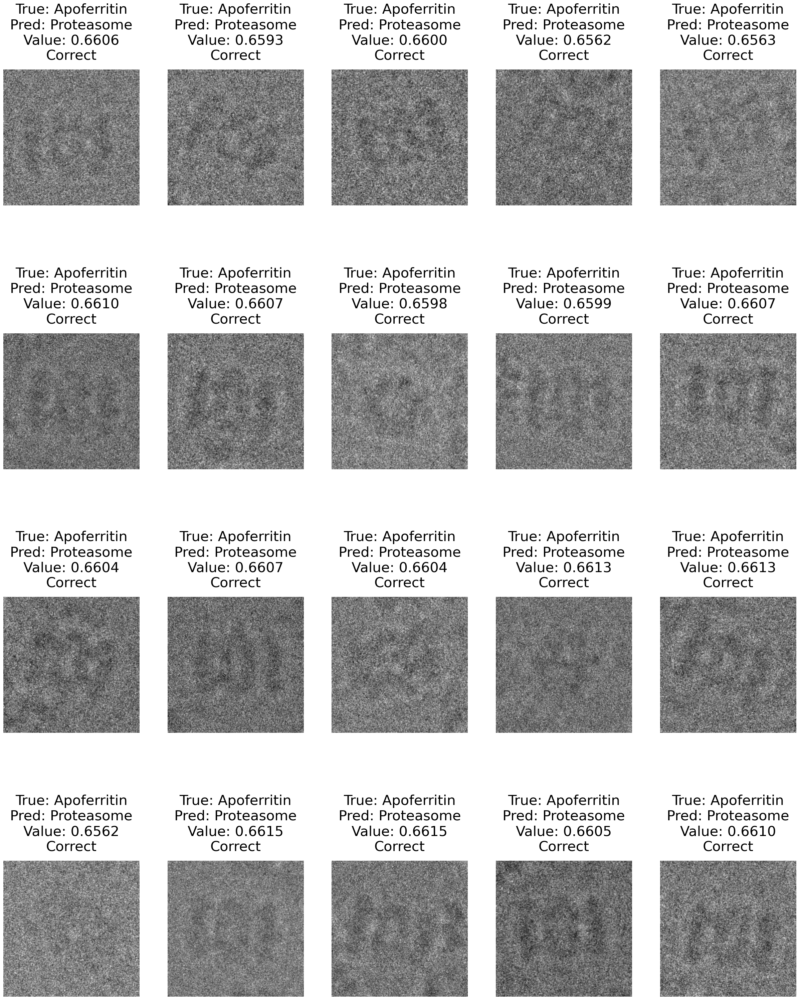

Accuracy: 100.00%


In [16]:
# Prediction the real data  (Proteasome_10188_200)
# using model CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_2.pth
# that was tarined on synthetic data anf last layers were retrained on real data:

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
import numpy as np

class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        self.fc1 = nn.Linear(128 * 28 * 28, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, 128 * 28 * 28)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x))) 
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x

model = MyModel()

# Load model function that adapts to whether the model was trained with DataParallel
def load_model(model_path, model, device):
    state_dict = torch.load(model_path, map_location="cpu")
    new_state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
    model.load_state_dict(new_state_dict)
    model = model.to(device)
    return model

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_path = '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_2.pth'
model = MyModel()
model = load_model(model_path, model, device)

# Define the image transform for validation (should be the same as during validation in training)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, file_paths, labels, transform=None):
        self.file_paths = file_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print(f"Error loading image; skipping index {idx}. Error: {e}")
            return None

        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]

def predict(model, data_loader, device):
    model.eval()
    results = {}
    pred_values = {}
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            predictions = torch.sigmoid(outputs).cpu().numpy()
            for idx, pred in enumerate(predictions):
                label = "Proteasome" if pred > 0.6 else "Apoferritin"
                results[labels[idx]] = label
                pred_values[labels[idx]] = pred.item()  # Extract scalar value
    return results, pred_values

# Path to your image folder
folder_path = "/home/semc/Aygul_DL/Deep-learning/Proteasome_10188_20"
file_paths = [os.path.join(folder_path, fname) for fname in os.listdir(folder_path) if fname.lower().endswith('.mrc')]
labels = [fname for fname in os.listdir(folder_path) if fname.lower().endswith('.mrc')]

# Create dataset and dataloader
test_dataset = MRCDataset(file_paths=file_paths, labels=labels, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Run predictions
results, pred_values = predict(model, test_loader, device)

# Print results and display images
num_images = len(results)
num_cols = 5
num_rows = math.ceil(num_images / num_cols)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(25, 8 * num_rows))
fig.tight_layout(pad=3.0)

# Flatten axes array if there's only one row
if num_rows == 1:
    axes = axes.reshape(1, -1)

correct_predictions = 0

for idx, (filename, prediction) in enumerate(results.items()):
    row = idx // num_cols
    col = idx % num_cols
    
    image_path = os.path.join(folder_path, filename)
    pred_value = pred_values[filename]
    
    try:
        with mrcfile.open(image_path, mode='r') as mrc:
            data = mrc.data.astype(np.float32)
            img = ((data - data.min()) / (data.max() - data.min()) * 255).astype(np.uint8)
            image = Image.fromarray(img)

        # Display image
        axes[row, col].imshow(image, cmap='gray')
        axes[row, col].axis('off')

        # Determine if prediction is correct
        correct = "Correct" if prediction == "Proteasome" else "Incorrect"
        color = 'black' if correct == "Correct" else 'red'

        if correct == "Correct":
            correct_predictions += 1

        # Display all information above the image
        axes[row, col].text(0.5, 1.05, f"True: Apoferritin\nPred: {prediction}\nValue: {pred_value:.4f}\n{correct}", 
                            color=color, fontsize=30, ha='center', va='bottom', 
                            transform=axes[row, col].transAxes)

    except Exception as e:
        print(f"Error displaying file {filename}: {e}")

# Remove any unused subplots
for idx in range(num_images, num_rows * num_cols):
    row = idx // num_cols
    col = idx % num_cols
    fig.delaxes(axes[row, col])

plt.show()

accuracy = correct_predictions / num_images * 100
print(f"Accuracy: {accuracy:.2f}%")

Conclusion: 100% accuracy! This tells me that retaraining last layers on real data from 2 different datasets works and preductions are accurate in test dataset.

Dataset m24jun19d had a thick ice. Maybe signal is not enough? I will try low pass fildeting the images.

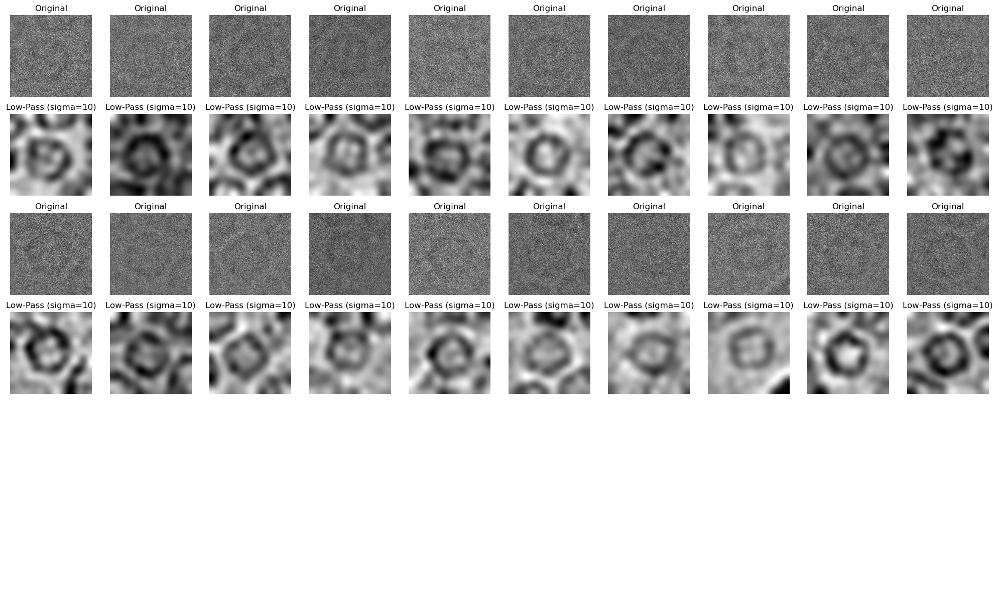

In [23]:
#Take a look at low pass filtered ApoF:
import numpy as np
import matplotlib.pyplot as plt
import mrcfile
from scipy.ndimage import gaussian_filter
import os

def load_mrc_image(file_path):
    with mrcfile.open(file_path, mode='r') as mrc:
        image_data = mrc.data.astype(np.float32)
        return image_data

def apply_low_pass_filter(image, sigma):
    return gaussian_filter(image, sigma=sigma)

def display_images(original_images, filtered_images, sigma):
    num_images = len(original_images)
    rows = (num_images // 10) + 1
    fig, ax = plt.subplots(2 * rows, 10, figsize=(20, 4 * rows))
    
    for i in range(num_images):
        row = i // 10
        col = i % 10
        ax[2 * row, col].imshow(original_images[i], cmap='gray')
        ax[2 * row, col].set_title('Original')
        ax[2 * row, col].axis('off')

        ax[2 * row + 1, col].imshow(filtered_images[i], cmap='gray')
        ax[2 * row + 1, col].set_title(f'Low-Pass (sigma={sigma})')
        ax[2 * row + 1, col].axis('off')

    for i in range(num_images, 10 * rows):
        ax[2 * (i // 10), i % 10].axis('off')
        ax[2 * (i // 10) + 1, i % 10].axis('off')
    
    plt.tight_layout()
    plt.show()

# Path to your MRC image folder
folder_path = '/home/semc/Aygul_DL/Deep-learning/m24jun19d_apoferritin_test'

# Load all MRC images in the folder
original_images = []
filtered_images = []
sigma = 10  # Adjust sigma for the desired level of filtering

for file_name in os.listdir(folder_path):
    if file_name.endswith('.mrc'):
        file_path = os.path.join(folder_path, file_name)
        original_image = load_mrc_image(file_path)
        filtered_image = apply_low_pass_filter(original_image, sigma)
        
        original_images.append(original_image)
        filtered_images.append(filtered_image)

# Display the original and filtered images
display_images(original_images, filtered_images, sigma)


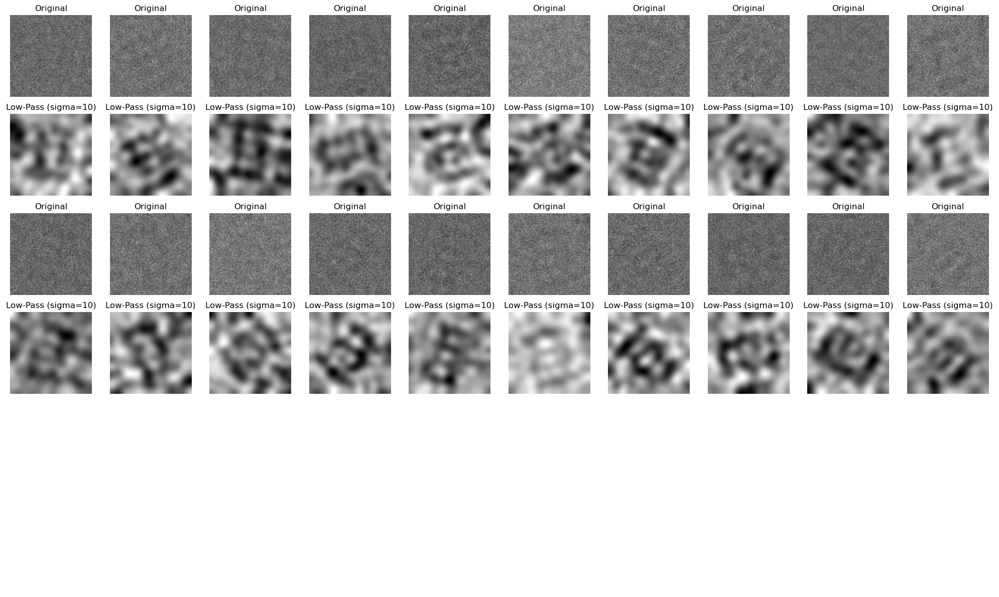

In [24]:
#Take a look at low pass filtered Proteasome:
import numpy as np
import matplotlib.pyplot as plt
import mrcfile
from scipy.ndimage import gaussian_filter
import os

def load_mrc_image(file_path):
    with mrcfile.open(file_path, mode='r') as mrc:
        image_data = mrc.data.astype(np.float32)
        return image_data

def apply_low_pass_filter(image, sigma):
    return gaussian_filter(image, sigma=sigma)

def display_images(original_images, filtered_images, sigma):
    num_images = len(original_images)
    rows = (num_images // 10) + 1
    fig, ax = plt.subplots(2 * rows, 10, figsize=(20, 4 * rows))
    
    for i in range(num_images):
        row = i // 10
        col = i % 10
        ax[2 * row, col].imshow(original_images[i], cmap='gray')
        ax[2 * row, col].set_title('Original')
        ax[2 * row, col].axis('off')

        ax[2 * row + 1, col].imshow(filtered_images[i], cmap='gray')
        ax[2 * row + 1, col].set_title(f'Low-Pass (sigma={sigma})')
        ax[2 * row + 1, col].axis('off')

    for i in range(num_images, 10 * rows):
        ax[2 * (i // 10), i % 10].axis('off')
        ax[2 * (i // 10) + 1, i % 10].axis('off')
    
    plt.tight_layout()
    plt.show()

# Path to your MRC image folder
folder_path = '/home/semc/Aygul_DL/Deep-learning/m24jun19d_proteasome_test'

# Load all MRC images in the folder
original_images = []
filtered_images = []
sigma = 10  # Adjust sigma for the desired level of filtering

for file_name in os.listdir(folder_path):
    if file_name.endswith('.mrc'):
        file_path = os.path.join(folder_path, file_name)
        original_image = load_mrc_image(file_path)
        filtered_image = apply_low_pass_filter(original_image, sigma)
        
        original_images.append(original_image)
        filtered_images.append(filtered_image)

# Display the original and filtered images
display_images(original_images, filtered_images, sigma)


I used to resize image as part of data augmentation. But now I want to remove it to avoid introducing artefacts. I will just do center crop of 150 pixels.

In [ ]:
# I decided to just center crop to 150 to avoid artefacts caused by resizing. I need to retrain model:

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
import numpy as np

def print_debug(statement):
    tz_NY = pytz.timezone('America/New_York')
    datetime_NY = datetime.now(tz_NY)
    print(f"{datetime_NY.strftime('%Y-%m-%d %H:%M:%S')} - DEBUG: {statement}")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print_debug(f"Using device: {device}")

dataset_path = "/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages"

train_transform = transforms.Compose([
    transforms.CenterCrop(150),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

test_transform = transforms.Compose([
    transforms.CenterCrop(150),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.file_paths = []
        self.labels = []
        self.label_dict = {'Apoferritin': 0, 'Proteasome': 1}
        
        for class_name in sorted(os.listdir(root_dir)):
            class_dir = os.path.join(root_dir, class_name)
            if os.path.isdir(class_dir):
                for file_name in sorted(os.listdir(class_dir)):
                    if file_name.endswith(".mrc"):
                        self.file_paths.append(os.path.join(class_dir, file_name))
                        self.labels.append(self.label_dict[class_name])
        
        print_debug(f"Total images found: {len(self.file_paths)}")

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print_debug(f"Error loading image; skipping index {idx}. Error: {e}")
            return None
        
        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]

full_dataset = MRCDataset(root_dir=dataset_path, transform=None)
full_dataset = [item for item in full_dataset if item is not None]
print_debug(f"Total valid images in dataset: {len(full_dataset)}")

if len(full_dataset) == 0:
    raise ValueError("No valid images found in the dataset. Please check the dataset path and file formats.")

train_size = int(0.8 * len(full_dataset))
test_size = len(full_dataset) - train_size
torch.manual_seed(0)  # Set a random seed for reproducibility
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

class CustomImageDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, transform=None):
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        image, label = self.dataset.dataset[self.dataset.indices[idx]]
        if self.transform:
            image = self.transform(image)
        return image, label

train_dataset = CustomImageDataset(train_dataset, transform=train_transform)
test_dataset = CustomImageDataset(test_dataset, transform=test_transform)

batch_size = 64

def collate_fn(batch):
    batch = list(filter(lambda x: x is not None, batch))
    return torch.utils.data.dataloader.default_collate(batch)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4, collate_fn=collate_fn)


class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        
        # Calculate the size of the flattened features
        self.feature_size = 128 * 18 * 18  # 150 -> 75 -> 37 -> 18
        
        self.fc1 = nn.Linear(self.feature_size, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, self.feature_size)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x)))
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x

model = MyModel()


if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)
model = model.to(device)

# Proper weight initialization
def weights_init(m):
    if isinstance(m, nn.Conv2d):
        nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='leaky_relu')
    elif isinstance(m, nn.Linear):
        nn.init.xavier_normal_(m.weight)

model.apply(weights_init)

optimizer = optim.Adam(model.parameters(), lr=0.0000001)
criterion = nn.BCELoss()

def evaluate_model(model, data_loader, criterion, device):
    model.eval()
    total_loss = 0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            labels = labels.float()  # Ensure labels are float for BCELoss
            loss = criterion(outputs, labels)
            total_loss += loss.item()
            predicted = torch.round(outputs)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    average_loss = total_loss / len(data_loader)
    accuracy = 100 * correct / total
    return average_loss, accuracy

# Evaluate the model initially
initial_train_loss, initial_train_accuracy = evaluate_model(model, train_loader, criterion, device)
initial_val_loss, initial_val_accuracy = evaluate_model(model, test_loader, criterion, device)

print_debug(f'Initial Train Loss: {initial_train_loss}, Initial Train Accuracy: {initial_train_accuracy}%')
print_debug(f'Initial Validation Loss: {initial_val_loss}, Initial Validation Accuracy: {initial_val_accuracy}%')

# Initialize lists for plotting
train_losses = [initial_train_loss]
val_losses = [initial_val_loss]
train_accuracies = [initial_train_accuracy]
val_accuracies = [initial_val_accuracy]

num_epochs = 150
best_val_loss = float('inf')
last_improvement = 0
patience = 50

# Implement gradient clipping
max_norm = 1.0  # Adjust the max norm value as needed

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0
    correct = 0
    total = 0
    for inputs, labels in train_loader:
        if inputs is None:
            continue
        inputs, labels = inputs.to(device), labels.to(device)
        labels = labels.float()
        optimizer.zero_grad()
        outputs = model(inputs)
        outputs = outputs.squeeze(1)
        loss = criterion(outputs, labels)
        loss.backward()
        
        # Apply gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)
        
        optimizer.step()

        train_loss += loss.item()
        predicted = (outputs > 0.5).float()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss /= len(train_loader)
    train_accuracy = 100 * correct / total
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    print_debug(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%.")

    model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            if inputs is None:
                continue
            inputs, labels = inputs.to(device), labels.to(device)
            labels = labels.float()
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            predicted = (outputs > 0.5).float()
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss /= len(test_loader)
    val_accuracy = 100 * val_correct / val_total
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    print_debug(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%.")

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        last_improvement = epoch
        torch.save(model.state_dict(), '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_2.pth')
        print_debug(f"Model improved and saved at epoch {epoch+1} into the file CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_2.pth")

    if epoch - last_improvement > patience:
        print_debug("No improvement in validation loss for several epochs, stopping training.")
        break

# Calculate the actual number of epochs data was collected
actual_num_epochs = len(train_losses)  # Assuming train_losses and val_losses are updated every epoch

plt.figure(figsize=(10, 4))

# Plot training and validation loss
plt.subplot(1, 2, 1)
plt.plot(range(actual_num_epochs), train_losses, label='Train Loss')
plt.plot(range(actual_num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epoch', color='black')
plt.ylabel('Loss', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(range(actual_num_epochs), train_accuracies, label='Train Accuracy')
plt.plot(range(actual_num_epochs), val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch', color='black')
plt.ylabel('Accuracy', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

plt.show()

In [ ]:
#Now, retrain last layers with low pass filtering of real images from dataset m24jun19d_apof_protea:
learning_rate = 0.0001
loss_pass_sigma = 5
num_epochs = 500
patience = 50

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import torch.nn.functional as F
import numpy as np
from collections import OrderedDict
from scipy.ndimage import gaussian_filter

def print_debug(statement):
    tz_NY = pytz.timezone('America/New_York')
    datetime_NY = datetime.now(tz_NY)
    print(f"{datetime_NY.strftime('%Y-%m-%d %H:%M:%S')} - DEBUG: {statement}")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print_debug(f"Using device: {device}")

dataset_path = "/home/semc/Aygul_DL/Deep-learning/m24jun19d_apof_protea"


train_transform = transforms.Compose([
    transforms.Lambda(lambda img: Image.fromarray(gaussian_filter(np.array(img), sigma=loss_pass_sigma))),  # Apply low-pass filtering
    transforms.CenterCrop(150),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

test_transform = transforms.Compose([
    transforms.Lambda(lambda img: Image.fromarray(gaussian_filter(np.array(img), sigma=loss_pass_sigma))),  # Apply low-pass filtering
    transforms.CenterCrop(150),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])


class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.file_paths = []
        self.labels = []
        self.label_dict = {'Apoferritin': 0, 'Proteasome': 1}

        for class_name in sorted(os.listdir(root_dir)):
            class_dir = os.path.join(root_dir, class_name)
            if os.path.isdir(class_dir):
                for file_name in sorted(os.listdir(class_dir)):
                    if file_name.endswith(".mrc"):
                        self.file_paths.append(os.path.join(class_dir, file_name))
                        self.labels.append(self.label_dict[class_name])

        print_debug(f"Total images found: {len(self.file_paths)}")

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print_debug(f"Error loading image; skipping index {idx}. Error: {e}")
            return None

        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]


full_dataset = MRCDataset(root_dir=dataset_path, transform=None)

full_dataset = [item for item in full_dataset if item is not None]
print_debug(f"Total valid images in dataset: {len(full_dataset)}")

if len(full_dataset) == 0:
    raise ValueError("No valid images found in the dataset. Please check the dataset path and file formats.")

train_size = int(0.8 * len(full_dataset))
test_size = len(full_dataset) - train_size
torch.manual_seed(0)  # Set a random seed for reproducibility
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

class CustomImageDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, transform=None):
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        image, label = self.dataset.dataset[self.dataset.indices[idx]]
        if self.transform:
            image = self.transform(image)
        return image, label

train_dataset = CustomImageDataset(train_dataset, transform=train_transform)
test_dataset = CustomImageDataset(test_dataset, transform=test_transform)

batch_size = 64

def collate_fn(batch):
    batch = list(filter(lambda x: x is not None, batch))
    return torch.utils.data.dataloader.default_collate(batch)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4, collate_fn=collate_fn)


class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        
        # Calculate the size of the flattened features
        self.feature_size = 128 * 18 * 18  # 150 -> 75 -> 37 -> 18
        
        self.fc1 = nn.Linear(self.feature_size, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, self.feature_size)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x)))
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x
        
def visualize_batch_images(data_loader, num_images=5):
    data_iter = iter(data_loader)
    images, labels = next(data_iter)
    images = images[:num_images]

    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))
    for i, img in enumerate(images):
        img = img.numpy().transpose((1, 2, 0))
        img = img * 0.5 + 0.5  # Unnormalize
        axes[i].imshow(img, cmap='gray')
        axes[i].axis('off')
    plt.show()

# Load the pretrained model
pretrained_model = MyModel()
pretrained_model = torch.nn.DataParallel(pretrained_model)
pretrained_model.load_state_dict(torch.load('/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_2.pth'))
pretrained_model = pretrained_model.module

# Replace the fully connected layers with new ones
pretrained_model.fc1 = nn.Linear(128 * 18 * 18, 128)
pretrained_model.batch_norm_fc1 = nn.BatchNorm1d(128)
pretrained_model.fc2 = nn.Linear(128, 1)
pretrained_model.batch_norm_fc2 = nn.BatchNorm1d(1)

# Freeze the convolutional layers
for param in pretrained_model.conv1.parameters():
    param.requires_grad = False
for param in pretrained_model.conv2.parameters():
    param.requires_grad = False
for param in pretrained_model.conv3.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm1.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm2.parameters():
    param.requires_grad = False
for param in pretrained_model.batch_norm3.parameters():
    param.requires_grad = False

# Unfreeze the fully connected layers
for param in pretrained_model.fc1.parameters():
    param.requires_grad = True
for param in pretrained_model.batch_norm_fc1.parameters():
    param.requires_grad = True
for param in pretrained_model.fc2.parameters():
    param.requires_grad = True
for param in pretrained_model.batch_norm_fc2.parameters():
    param.requires_grad = True

# Assign the pretrained_model to model
model = pretrained_model

if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)
model = model.to(device)


# Proper weight initialization
def weights_init(m):
    if isinstance(m, nn.Linear):
        if m.weight.requires_grad:
            nn.init.xavier_normal_(m.weight)

model.apply(weights_init)

# Only optimize the fully connected layers
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=learning_rate)
criterion = nn.BCELoss()

def evaluate_model(model, data_loader, criterion, device):
    model.eval()
    total_loss = 0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            labels = labels.float()  # Ensure labels are float for BCELoss
            loss = criterion(outputs, labels)
            total_loss += loss.item()
            predicted = torch.round(outputs)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    average_loss = total_loss / len(data_loader)
    accuracy = 100 * correct / total
    return average_loss, accuracy

# Evaluate the model initially
initial_train_loss, initial_train_accuracy = evaluate_model(model, train_loader, criterion, device)
initial_val_loss, initial_val_accuracy = evaluate_model(model, test_loader, criterion, device)

print_debug(f'Initial Train Loss: {initial_train_loss}, Initial Train Accuracy: {initial_train_accuracy}%')
print_debug(f'Initial Validation Loss: {initial_val_loss}, Initial Validation Accuracy: {initial_val_accuracy}%')

# Initialize lists for plotting
train_losses = [initial_train_loss]
val_losses = [initial_val_loss]
train_accuracies = [initial_train_accuracy]
val_accuracies = [initial_val_accuracy]

num_epochs = num_epochs
best_val_loss = float('inf')
last_improvement = 0
patience = patience

# Implement gradient clipping
max_norm = 1.0  # Adjust the max norm value as needed

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0
    correct = 0
    total = 0
    for batch_idx, (inputs, labels) in enumerate(train_loader):
        if inputs is None:
            continue
        inputs, labels = inputs.to(device), labels.to(device)
        labels = labels.float()
        optimizer.zero_grad()
        outputs = model(inputs)
        outputs = outputs.squeeze(1)
        loss = criterion(outputs, labels)
        loss.backward()
        
        # Apply gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)
        
        optimizer.step()

        train_loss += loss.item()
        predicted = (outputs > 0.5).float()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        # Visualize images for the first batch of each epoch
        if batch_idx == 0:
            print_debug(f"Epoch {epoch+1} - Visualizing batch images")
            visualize_batch_images(train_loader, num_images=5)

    train_loss /= len(train_loader)
    train_accuracy = 100 * correct / total
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    print_debug(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%.")

    model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            if inputs is None:
                continue
            inputs, labels = inputs.to(device), labels.to(device)
            labels = labels.float()
            outputs = model(inputs)
            outputs = outputs.squeeze(1)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            predicted = (outputs > 0.5).float()
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()

    val_loss /= len(test_loader)
    val_accuracy = 100 * val_correct / val_total
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)
    print_debug(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%.")

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        last_improvement = epoch
        torch.save(model.state_dict(), '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_5.pth')
        print_debug(f"Model improved and saved at epoch {epoch+1} into the file CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_5.pth")

    if epoch - last_improvement > patience:
        print_debug("No improvement in validation loss for several epochs, stopping training.")
        break

# Calculate the actual number of epochs data was collected
actual_num_epochs = len(train_losses)  # Assuming train_losses and val_losses are updated every epoch

plt.figure(figsize=(10, 4))

# Plot training and validation loss
plt.subplot(1, 2, 1)
plt.plot(range(actual_num_epochs), train_losses, label='Train Loss')
plt.plot(range(actual_num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epoch', color='black')
plt.ylabel('Loss', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

# Plot training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(range(actual_num_epochs), train_accuracies, label='Train Accuracy')
plt.plot(range(actual_num_epochs), val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch', color='black')
plt.ylabel('Accuracy', color='black')
plt.tick_params(axis='both', colors='black')
plt.legend()

plt.show()

/tmp/ipykernel_47809/2280615643.py:56: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(model_path, map_location="cpu")


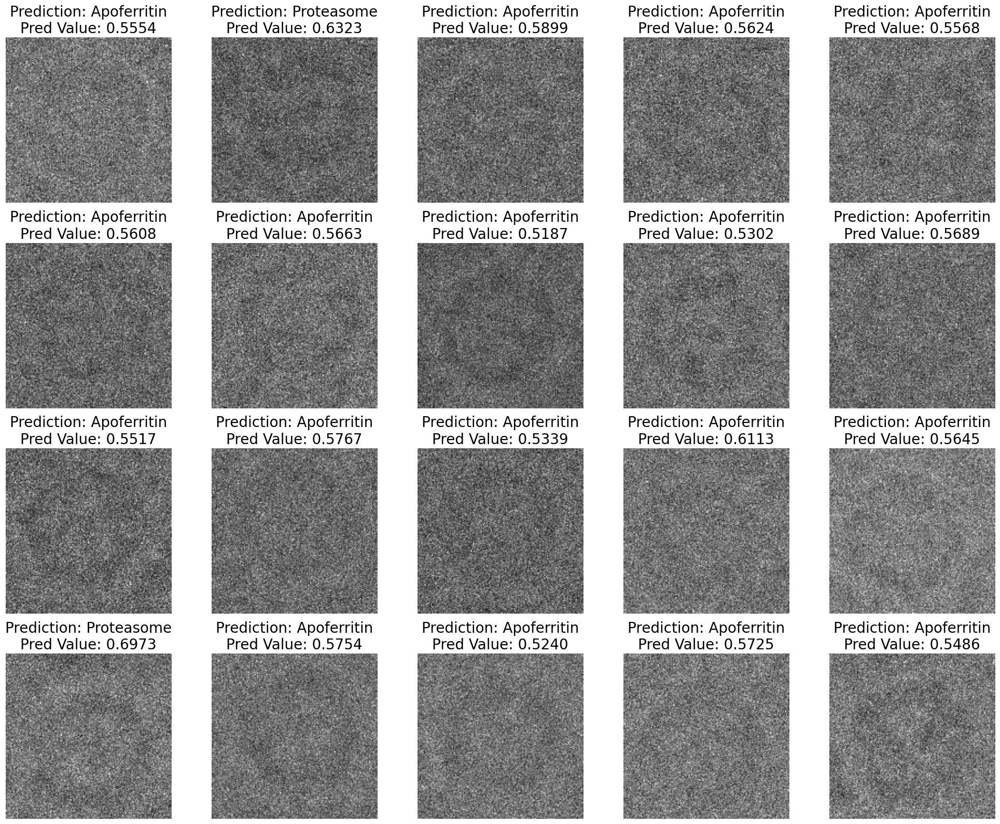

Apoferritin: 90.00%
Proteasome: 10.00%


In [20]:
# Prediction on the same ApoF data (/home/semc/Aygul_DL/Deep-learning/m24jun19d_apoferritin_test_150):
threshold = 0.62
loss_pass_sigma = 5

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import gaussian_filter

class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        
        # Calculate the size of the flattened features
        self.feature_size = 128 * 18 * 18  # 150 -> 75 -> 37 -> 18
        
        self.fc1 = nn.Linear(self.feature_size, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, self.feature_size)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x)))
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x

model = MyModel()

# Load model function that adapts to whether the model was trained with DataParallel
def load_model(model_path, model, device):
    state_dict = torch.load(model_path, map_location="cpu")
    new_state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
    model.load_state_dict(new_state_dict)
    model = model.to(device)
    return model

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_path = '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_5.pth'
model = MyModel()
model = load_model(model_path, model, device)

# Define the image transform for validation (should be the same as during validation in training)
transform = transforms.Compose([
    transforms.Lambda(lambda img: Image.fromarray(gaussian_filter(np.array(img), sigma=loss_pass_sigma))),  # Apply low-pass filtering
    transforms.CenterCrop(150),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, file_paths, labels, transform=None):
        self.file_paths = file_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print(f"Error loading image; skipping index {idx}. Error: {e}")
            return None

        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]

def predict(model, data_loader, device):
    model.eval()
    results = {}
    pred_values = {}
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            predictions = torch.sigmoid(outputs).cpu().detach().numpy()
            for idx, pred in enumerate(predictions):
                label = "Proteasome" if pred > threshold else "Apoferritin"
                results[labels[idx]] = label
                pred_values[labels[idx]] = pred.item()  # Extract scalar value
    return results, pred_values

# Path to your image folder
folder_path = "/home/semc/Aygul_DL/Deep-learning/m24jun19d_apoferritin_test_150"
file_paths = [os.path.join(folder_path, fname) for fname in os.listdir(folder_path) if fname.lower().endswith('.mrc')]
labels = [fname for fname in os.listdir(folder_path) if fname.lower().endswith('.mrc')]

# Create dataset and dataloader
test_dataset = MRCDataset(file_paths=file_paths, labels=labels, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Run predictions
results, pred_values = predict(model, test_loader, device)

# Print results and display images

num_images = len(file_paths)
rows = num_images // 5 + (num_images % 5 > 0)
fig, axes = plt.subplots(rows, 5, figsize=(20, 4 * rows))

for idx, filename in enumerate(results):
    image_path = os.path.join(folder_path, filename)
    pred_value = pred_values[filename]
    try:
        with mrcfile.open(image_path, mode='r') as mrc:
            data = mrc.data.astype(np.float32)
            img = ((data - data.min()) / (data.max() - data.min()) * 255).astype(np.uint8)
            image = Image.fromarray(img)
        
        row, col = divmod(idx, 5)
        axes[row, col].imshow(image, cmap='gray')
        axes[row, col].axis('off')
        axes[row, col].set_title(f"Prediction: {results[filename]}\nPred Value: {pred_value:.4f}", fontsize=20)

    except Exception as e:
        print(f"Error displaying file {filename}: {e}")

# Hide any remaining empty subplots
for idx in range(num_images, rows * 5):
    row, col = divmod(idx, 5)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

# Calculate and print the percentage of each label in the output
total_count = len(results)
proteasome_count = sum(1 for label in results.values() if label == "Proteasome")
apoferritin_count = total_count - proteasome_count

proteasome_percent = (proteasome_count / total_count) * 100
apoferritin_percent = (apoferritin_count / total_count) * 100

print(f"Apoferritin: {apoferritin_percent:.2f}%")
print(f"Proteasome: {proteasome_percent:.2f}%")


/tmp/ipykernel_47809/3874525718.py:56: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(model_path, map_location="cpu")


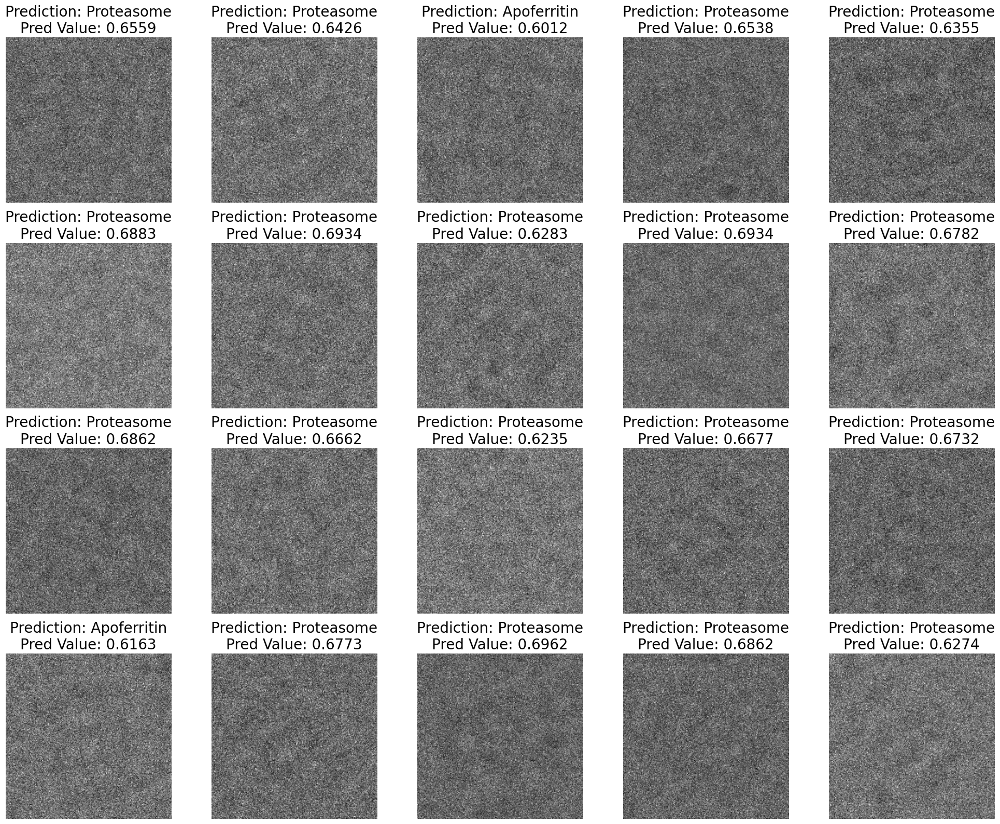

Apoferritin: 10.00%
Proteasome: 90.00%


In [21]:
# Prediction on the same ApoF data (/home/semc/Aygul_DL/Deep-learning/m24jun19d_apoferritin_test_150):
threshold = 0.62
loss_pass_sigma = 5

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import gaussian_filter

class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        
        # Calculate the size of the flattened features
        self.feature_size = 128 * 18 * 18  # 150 -> 75 -> 37 -> 18
        
        self.fc1 = nn.Linear(self.feature_size, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, self.feature_size)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x)))
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x

model = MyModel()

# Load model function that adapts to whether the model was trained with DataParallel
def load_model(model_path, model, device):
    state_dict = torch.load(model_path, map_location="cpu")
    new_state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
    model.load_state_dict(new_state_dict)
    model = model.to(device)
    return model

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_path = '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_5.pth'
model = MyModel()
model = load_model(model_path, model, device)

# Define the image transform for validation (should be the same as during validation in training)
transform = transforms.Compose([
    transforms.Lambda(lambda img: Image.fromarray(gaussian_filter(np.array(img), sigma=loss_pass_sigma))),  # Apply low-pass filtering
    transforms.CenterCrop(150),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, file_paths, labels, transform=None):
        self.file_paths = file_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print(f"Error loading image; skipping index {idx}. Error: {e}")
            return None

        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx]

def predict(model, data_loader, device):
    model.eval()
    results = {}
    pred_values = {}
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            predictions = torch.sigmoid(outputs).cpu().detach().numpy()
            for idx, pred in enumerate(predictions):
                label = "Proteasome" if pred > threshold else "Apoferritin"
                results[labels[idx]] = label
                pred_values[labels[idx]] = pred.item()  # Extract scalar value
    return results, pred_values

# Path to your image folder
folder_path = "/home/semc/Aygul_DL/Deep-learning/m24jun19d_proteasome_test"
file_paths = [os.path.join(folder_path, fname) for fname in os.listdir(folder_path) if fname.lower().endswith('.mrc')]
labels = [fname for fname in os.listdir(folder_path) if fname.lower().endswith('.mrc')]

# Create dataset and dataloader
test_dataset = MRCDataset(file_paths=file_paths, labels=labels, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Run predictions
results, pred_values = predict(model, test_loader, device)

# Print results and display images

num_images = len(file_paths)
rows = num_images // 5 + (num_images % 5 > 0)
fig, axes = plt.subplots(rows, 5, figsize=(20, 4 * rows))

for idx, filename in enumerate(results):
    image_path = os.path.join(folder_path, filename)
    pred_value = pred_values[filename]
    try:
        with mrcfile.open(image_path, mode='r') as mrc:
            data = mrc.data.astype(np.float32)
            img = ((data - data.min()) / (data.max() - data.min()) * 255).astype(np.uint8)
            image = Image.fromarray(img)
        
        row, col = divmod(idx, 5)
        axes[row, col].imshow(image, cmap='gray')
        axes[row, col].axis('off')
        axes[row, col].set_title(f"Prediction: {results[filename]}\nPred Value: {pred_value:.4f}", fontsize=20)

    except Exception as e:
        print(f"Error displaying file {filename}: {e}")

# Hide any remaining empty subplots
for idx in range(num_images, rows * 5):
    row, col = divmod(idx, 5)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

# Calculate and print the percentage of each label in the output
total_count = len(results)
proteasome_count = sum(1 for label in results.values() if label == "Proteasome")
apoferritin_count = total_count - proteasome_count

proteasome_percent = (proteasome_count / total_count) * 100
apoferritin_percent = (apoferritin_count / total_count) * 100

print(f"Apoferritin: {apoferritin_percent:.2f}%")
print(f"Proteasome: {proteasome_percent:.2f}%")


/tmp/ipykernel_47809/2838183497.py:56: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(model_path, map_location="cpu")


Total images found: 40


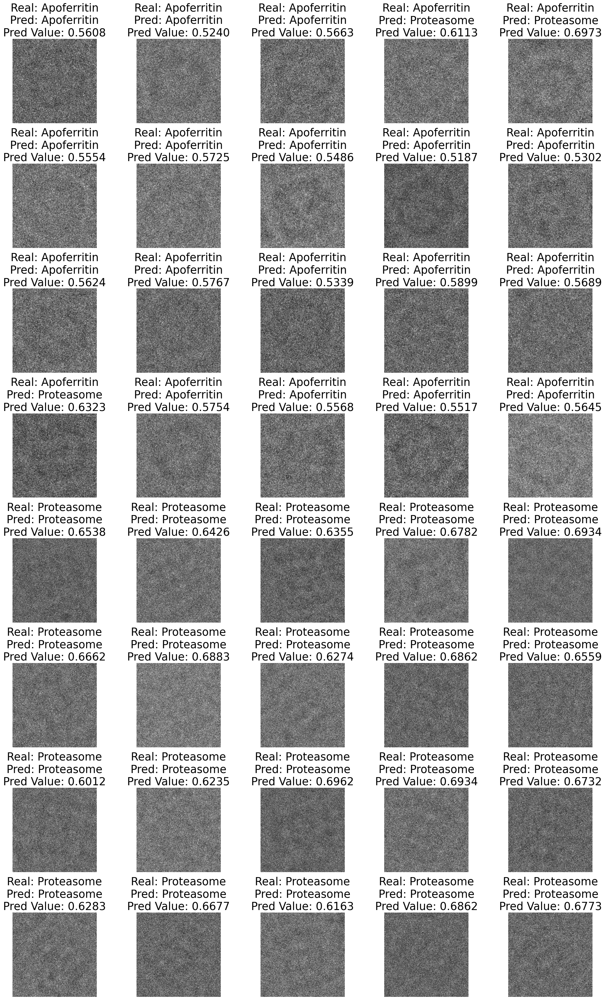

Accuracy: 92.50%


In [22]:
# Prediction on real images m24jun19d_apof_protea_test both apoferritin and protesome to calculate final accuracy:
threshold = 0.6
loss_pass_sigma = 5

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader
from PIL import Image, UnidentifiedImageError
import mrcfile
import os
import pytz
from datetime import datetime
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import gaussian_filter

class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, padding=1)
        self.batch_norm1 = nn.BatchNorm2d(32)
        self.pool1 = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(64)
        self.pool2 = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(64, 128, 3, padding=1)
        self.batch_norm3 = nn.BatchNorm2d(128)
        self.pool3 = nn.MaxPool2d(2, 2)
        self.dropout = nn.Dropout(0.5)
        
        # Calculate the size of the flattened features
        self.feature_size = 128 * 18 * 18  # 150 -> 75 -> 37 -> 18
        
        self.fc1 = nn.Linear(self.feature_size, 128)
        self.batch_norm_fc1 = nn.BatchNorm1d(128)
        self.fc2 = nn.Linear(128, 1)
        self.batch_norm_fc2 = nn.BatchNorm1d(1)

    def forward(self, x):
        x = self.pool1(F.leaky_relu(self.batch_norm1(self.conv1(x))))
        x = self.pool2(F.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.pool3(F.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = x.view(-1, self.feature_size)
        x = self.dropout(x)
        x = F.leaky_relu(self.batch_norm_fc1(self.fc1(x)))
        x = self.dropout(x)
        x = torch.sigmoid(self.batch_norm_fc2(self.fc2(x)))
        return x

model = MyModel()

# Load model function that adapts to whether the model was trained with DataParallel
def load_model(model_path, model, device):
    state_dict = torch.load(model_path, map_location="cpu")
    new_state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
    model.load_state_dict(new_state_dict)
    model = model.to(device)
    return model

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_path = '/home/semc/Aygul_DL/Deep-learning/cryoEM_RegularIce_100kImages/CryoEM_model_100kxImages_regularIce_withAgmentation_withBatchnorm_withDropoutLayers_withEarlyStop_lr0_0000001_LeakyRelu_FCbatchNorm_grandClip_1_lastLayerRetrain_5.pth'
model = MyModel()
model = load_model(model_path, model, device)

# Define the image transform for validation (should be the same as during validation in training)
transform = transforms.Compose([
    transforms.Lambda(lambda img: Image.fromarray(gaussian_filter(np.array(img), sigma=loss_pass_sigma))),  # Apply low-pass filtering
    transforms.CenterCrop(150),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

class MRCDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.file_paths = []
        self.labels = []
        self.label_dict = {'Apoferritin': 0, 'Proteasome': 1}
        self.label_dict_inv = {0: 'Apoferritin', 1: 'Proteasome'}

        for class_name in sorted(os.listdir(root_dir)):
            class_dir = os.path.join(root_dir, class_name)
            if os.path.isdir(class_dir):
                for file_name in sorted(os.listdir(class_dir)):
                    if file_name.endswith(".mrc"):
                        self.file_paths.append(os.path.join(class_dir, file_name))
                        self.labels.append(self.label_dict[class_name])

        print(f"Total images found: {len(self.file_paths)}")

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        file_path = self.file_paths[idx]
        try:
            with mrcfile.open(file_path, mode='r') as mrc:
                image = mrc.data.astype(np.float32)
                image = np.expand_dims(image, axis=0)  # Add channel dimension
                image = Image.fromarray(image[0], mode='F')
        except (IOError, UnidentifiedImageError) as e:
            print(f"Error loading image; skipping index {idx}. Error: {e}")
            return None

        if self.transform:
            image = self.transform(image)
        return image, self.labels[idx], file_path

def predict(model, data_loader, device):
    model.eval()
    results = {}
    pred_values = {}
    accurate_predictions = 0
    total_predictions = 0
    with torch.no_grad():
        for inputs, true_labels, file_path in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            predictions = torch.sigmoid(outputs).cpu().detach().numpy()
            for idx, pred in enumerate(predictions):
                predicted_label = 1 if pred > threshold else 0
                real_label = true_labels[idx].item()
                label_str = "Proteasome" if predicted_label == 1 else "Apoferritin"
                results[file_path[idx]] = (real_label, predicted_label, label_str)
                pred_values[file_path[idx]] = pred.item()  # Extract scalar value
                
                # Check accuracy
                if predicted_label == real_label:
                    accurate_predictions += 1
                total_predictions += 1

    accuracy = (accurate_predictions / total_predictions) * 100
    return results, pred_values, accuracy

# Path to your image folder
folder_path = "/home/semc/Aygul_DL/Deep-learning/m24jun19d_apof_protea_test"

# Create dataset and dataloader
test_dataset = MRCDataset(root_dir=folder_path, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Run predictions
results, pred_values, accuracy = predict(model, test_loader, device)

# Print results and display images

num_images = len(test_dataset)
rows = num_images // 5 + (num_images % 5 > 0)
fig, axes = plt.subplots(rows, 5, figsize=(20, 4 * rows))

for idx, image_path in enumerate(test_dataset.file_paths):
    real_label, predicted_label, pred_label_str = results[image_path]
    pred_value = pred_values[image_path]
    try:
        with mrcfile.open(image_path, mode='r') as mrc:
            data = mrc.data.astype(np.float32)
            img = ((data - data.min()) / (data.max() - data.min()) * 255).astype(np.uint8)
            image = Image.fromarray(img)
        
        row, col = divmod(idx, 5)
        axes[row, col].imshow(image, cmap='gray')
        axes[row, col].axis('off')
        axes[row, col].set_title(f"Real: {test_dataset.label_dict_inv[real_label]}\nPred: {pred_label_str}\nPred Value: {pred_value:.4f}", fontsize=25)

    except Exception as e:
        print(f"Error displaying file {image_path}: {e}")

# Hide any remaining empty subplots
for idx in range(num_images, rows * 5):
    row, col = divmod(idx, 5)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

# Print accuracy
print(f"Accuracy: {accuracy:.2f}%")


Conclusion: Final accuracy is 92.50%.


Training on synthetic data generated with VirtualIce software from Alex J. Noble to create cropped images of Apoferritin (PDB ID: 8RQB) and Proteasome (PDB ID: 1PMA), then retraining last layers on real data m24jun19d (collected and manually picked 400+400 Apoferritin and Proteasome particles by Aygul Ishemgulova) works well. Prediction on held-out real m24jun19d data shows 92.50% accuracy.